# Top Level Notebook For All the Plots Excluding Stability and Tuning

## Set up

In [4]:
import os
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import pdb
import sys

from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from scipy import stats

from collections import defaultdict
%matplotlib inline
%load_ext autoreload
%autoreload 2

outputdir = "C:\\Files\\UM\\ND\\SFN"
preprocessingdir = os.path.join("C:\\Files\\UM\\ND\\SFN","preprocessing_092024_no7822nofalcon")
characterizationdir = outputdir
perf_dir = 'C:\\Files\\UM\\ND\\big_nhp_dataset_code\\sfn_stuff' #dir to sfn_stuff

In [5]:
def get_good_days():
    # review_results = pd.read_csv(config.reviewpath)
    # # filter out bad days
    # good_days = review_results.loc[review_results['Status'] == 'good']

    # #create histogram for current version (fewer days I guess?)
    # dates = good_days['Date'].to_numpy()

    filenames = [f for f in os.listdir(preprocessingdir) if not f.startswith('.')] #in case there are any hidden files
    filenames.remove('bad_days.txt')
    filenames.sort()
    dates = [file[0:10] for file in filenames]
    return dates

In [6]:
dates =  get_good_days()

## Dataset Count over Time Histogram

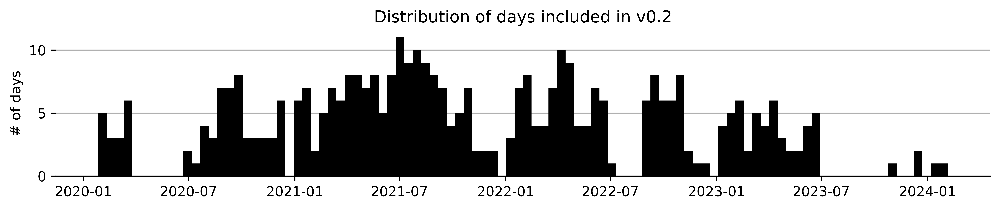

In [ ]:
from plotters.DatasetCountoverTime import dataset_count_over_time
dataset_count_over_time(dates, outputdir)

## Target Positions

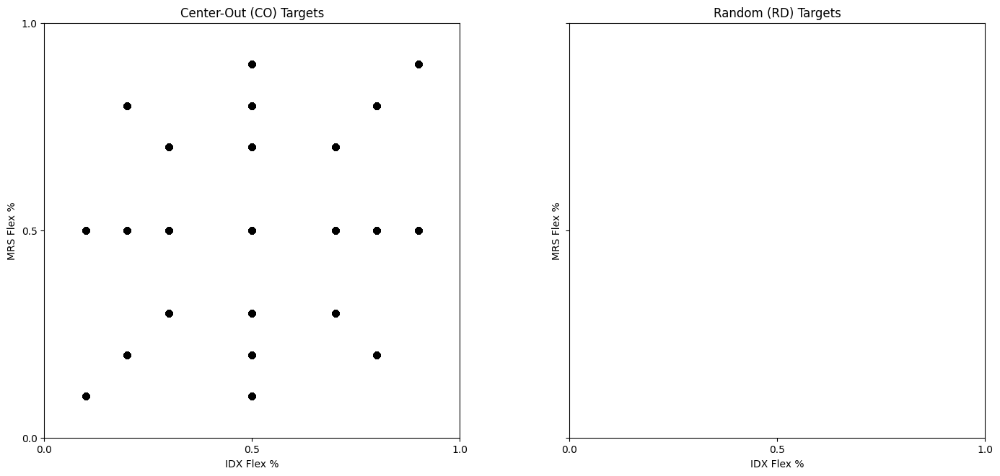

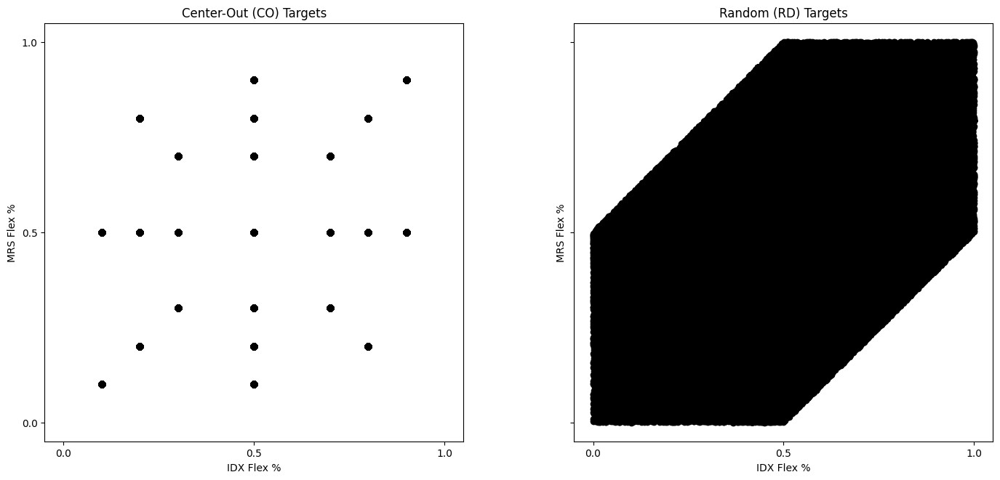

In [ ]:
from plotters.TargetPositions import target_positions
target_positions(dates,preprocessingdir,outputdir, isOneDay=True, dayIdx = 3)
target_positions(dates,preprocessingdir,outputdir, isOneDay=False)

## Daily Trained Ridge Regression Performance over Time

 Date Processing: 2024-02-05(385,)
385


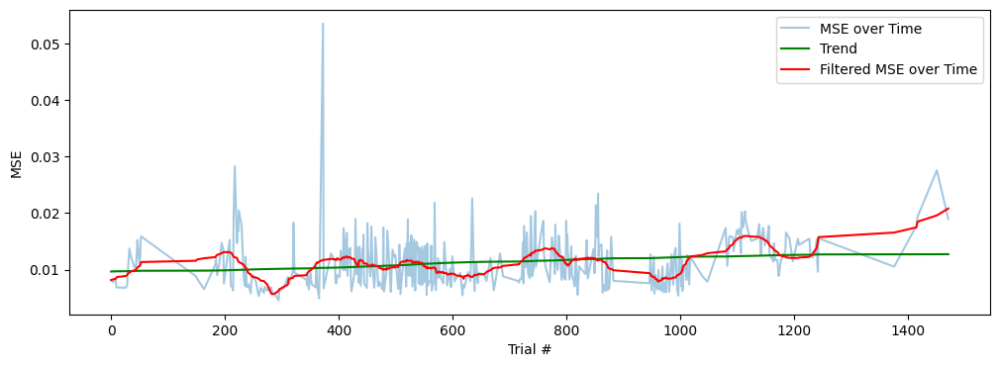

(386, 1)


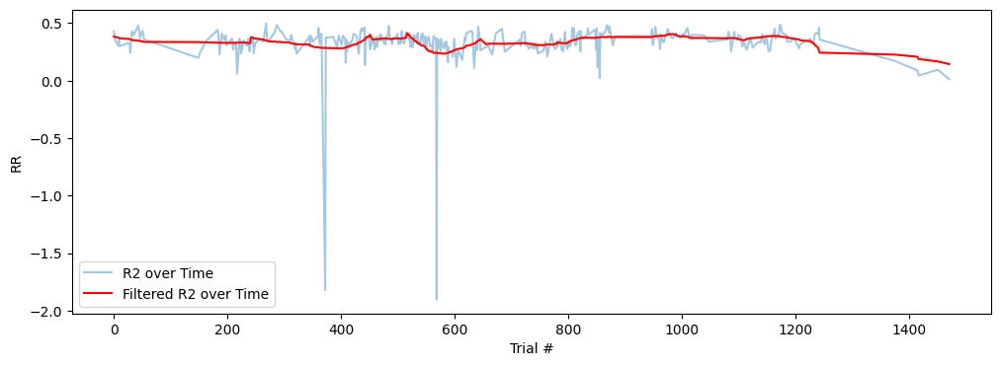

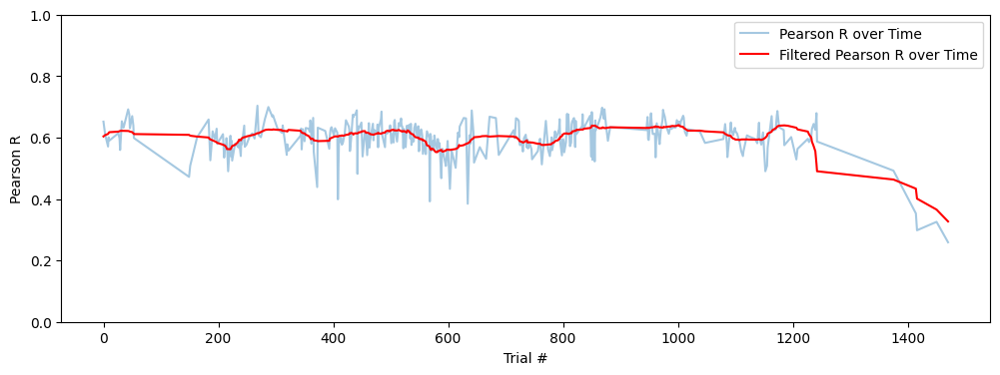

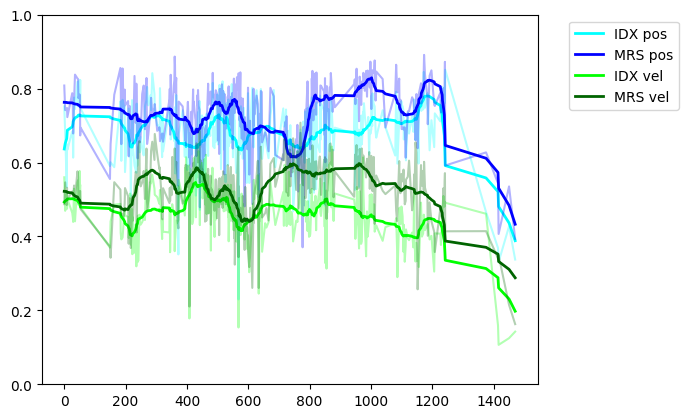

In [ ]:
from plotters.RidgeRegression import daily_ridge_regression_perf
daily_ridge_regression_perf(dates,preprocessingdir,characterizationdir)

## Old Daily Trained Model Performance over Time

As neuro core hub has not been finalized, the LSTM part is left undone until neuro core hub is done. Old data is used here as placeholder and TODO: delete this section and replace it with new LSTM part of the code is done in neuro core hub.

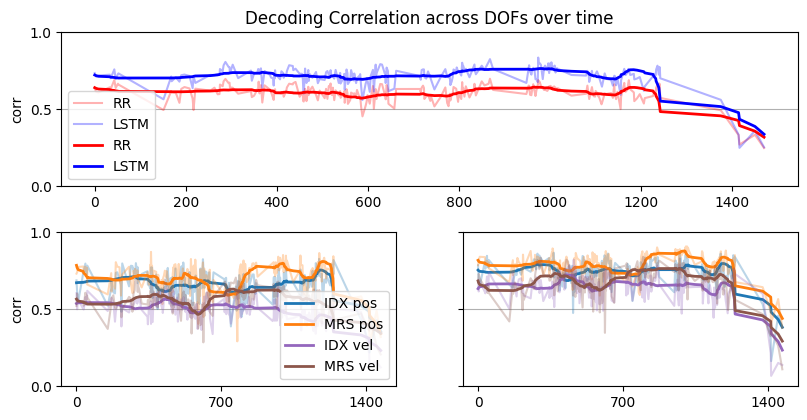

In [ ]:
from plotters.OldPerformanceoverTime import models_daily_perfs_over_time_old
models_daily_perfs_over_time_old(perf_dir,characterizationdir)

## Relative Model Performance over Time

744073
nan


c:\Files\UM\ND\big_nhp_dataset_code\plotters\OldPerformanceoverTime.py:208: RuntimeWarning: Degrees of freedom <= 0 for slice.
  variance = np.nanvar(data, axis = 0)


0
1


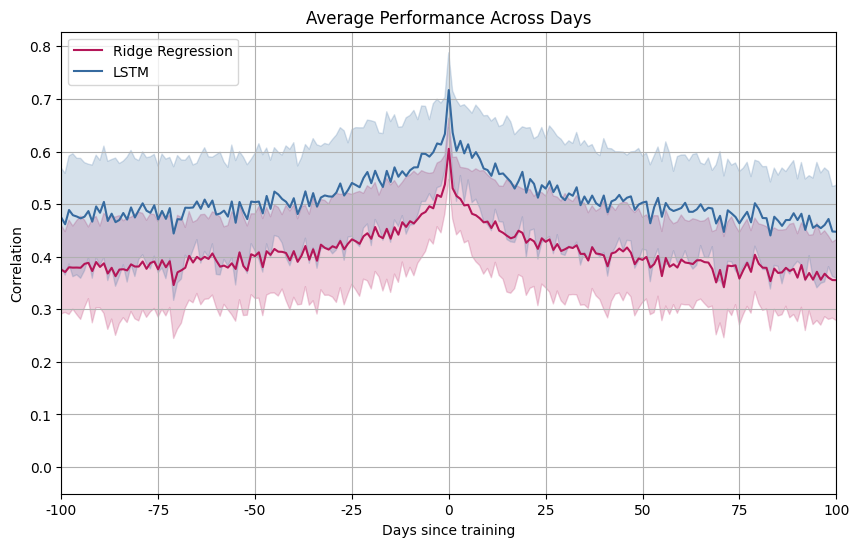

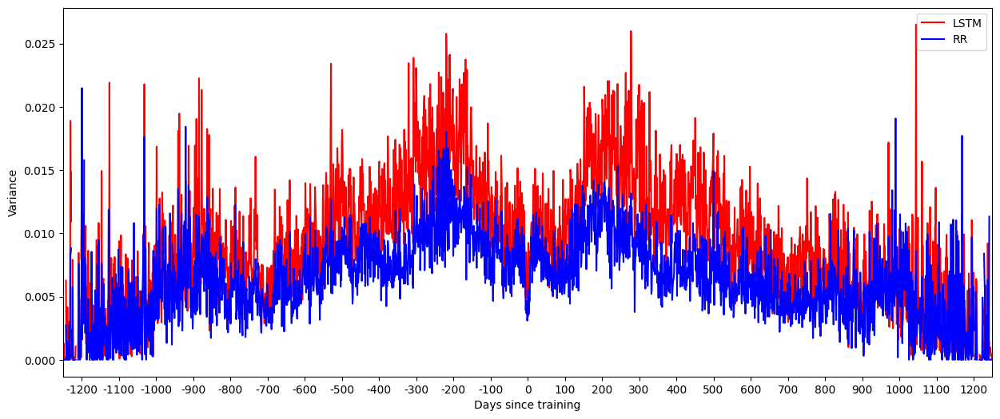

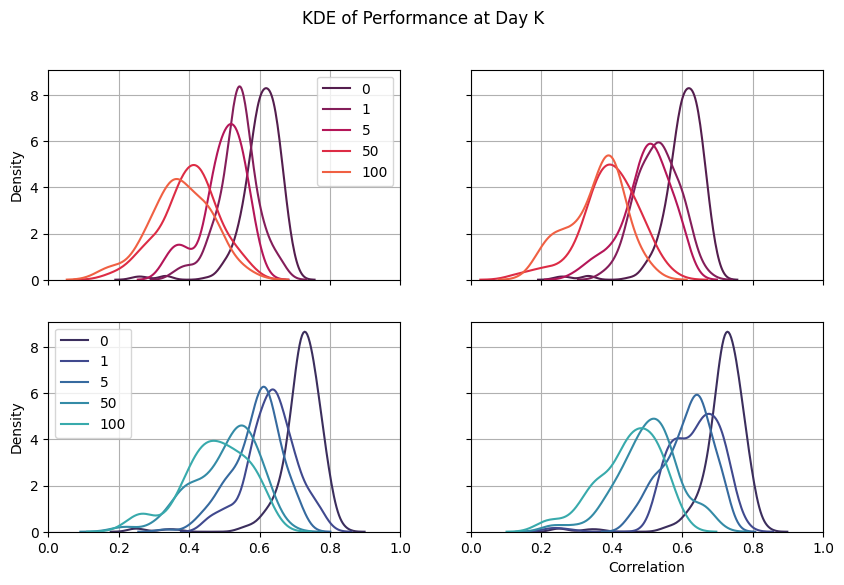

In [ ]:
from plotters.OldPerformanceoverTime import models_relative_perfs_over_time_old
models_relative_perfs_over_time_old(perf_dir, characterizationdir)

## SBP Mean / Distribution (w/ mean and median) over Time

### SBP Mean over Time

In [ ]:
from plotters.SBP import calc_avg_sbps, signal_power_over_time
calc_avg_sbps(dates,preprocessingdir,characterizationdir)

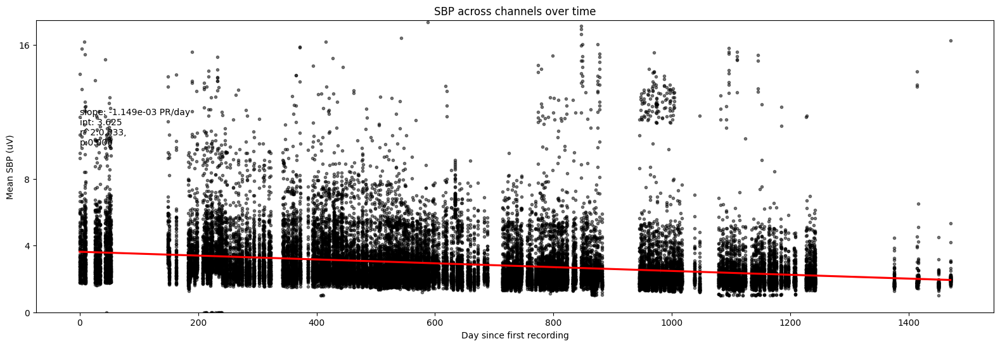

In [13]:
signal_power_over_time(dates, characterizationdir, crunch=False)

### SBP Distribution over Time

In [ ]:
from plotters.SBP import sbp_distributions, signal_distribution_per_ch
channels = 4
# channels = [1,3,5] # select multiple channels
# channels = (1,5) # select range of channels
sbp_distributions(dates,channels,preprocessingdir,characterizationdir)


,date,value
0,2020-01-27,22.025
1,2020-01-27,17.275
2,2020-01-27,22.825
3,2020-01-27,28.350
4,2020-01-27,26.875
...,...,...
9876879,2024-02-05,5.000
9876880,2024-02-05,4.675
9876881,2024-02-05,5.900
9876882,2024-02-05,6.725


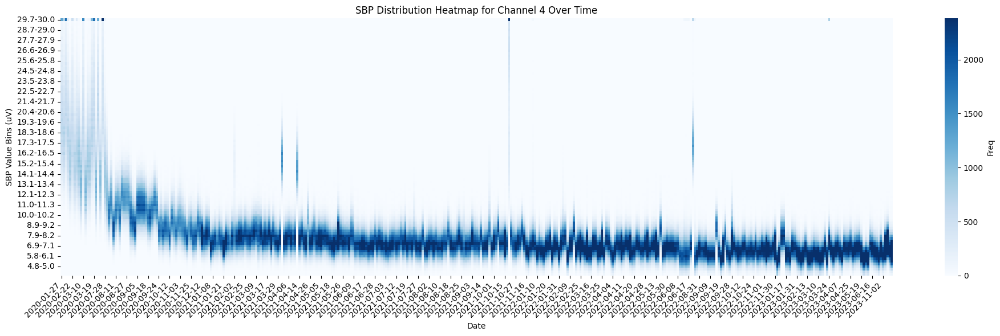

In [20]:
# arbitrary channel 4 is chosen here:
channel_chosen = 4
fig, ax = plt.subplots(1, 1, figsize = (19.5, 6), sharex=True)
signal_distribution_per_ch(dates, ax,channel_chosen, preprocessingdir, characterizationdir,100,display_mean=False,display_median=False, crunch=False)
plt.savefig(os.path.join(characterizationdir, f"sbp_distributions_{4}_same.png"))

### SBP Distribution over Time Graphs for All Channels

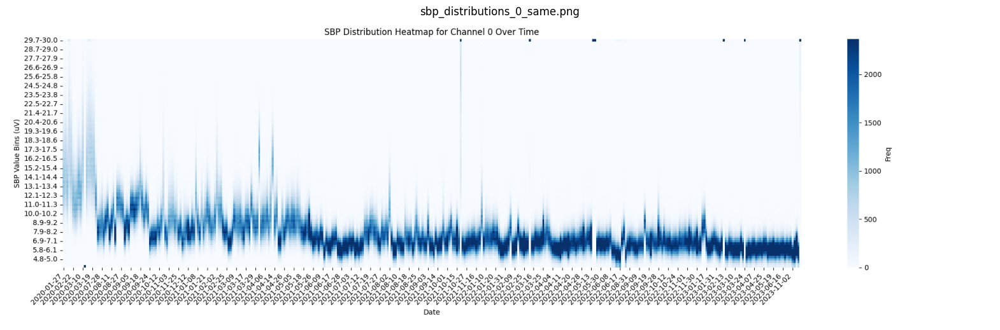

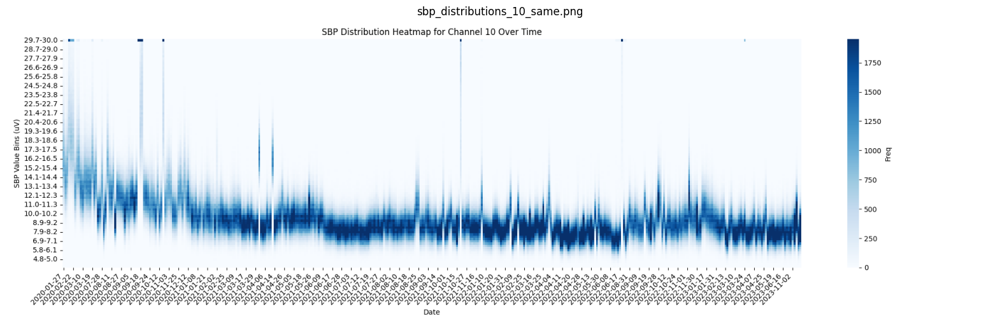

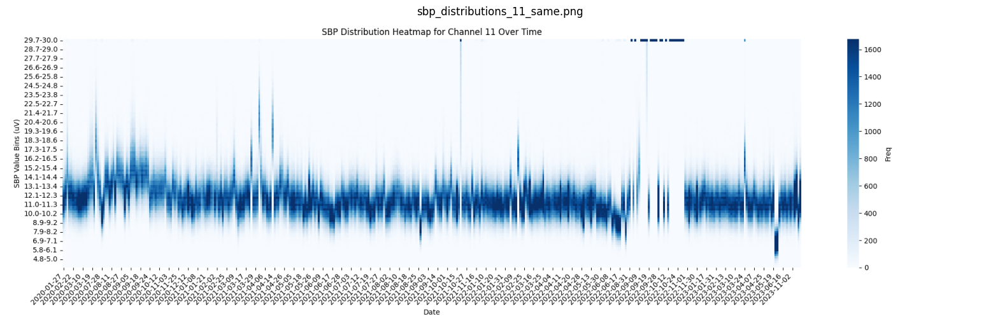

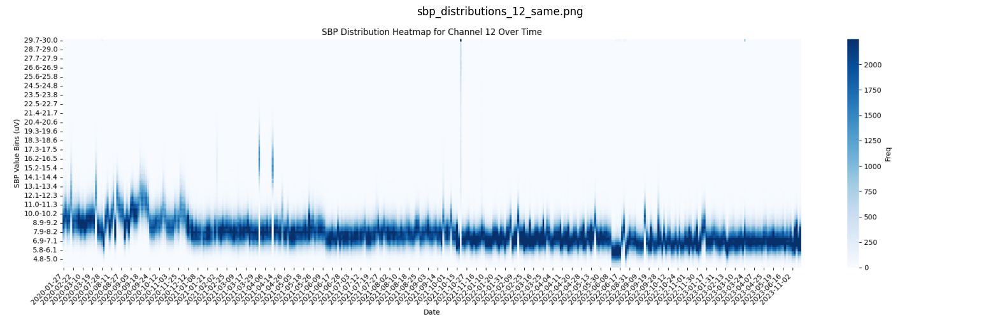

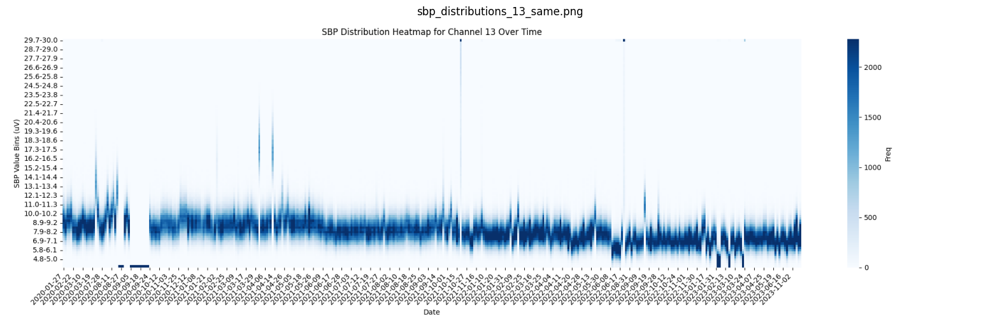

...

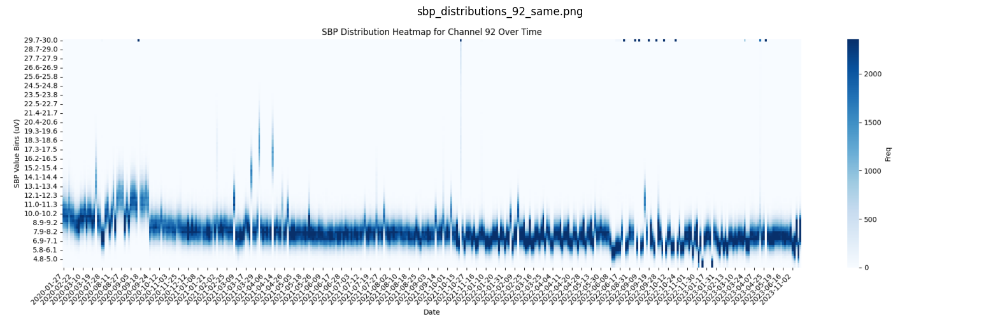

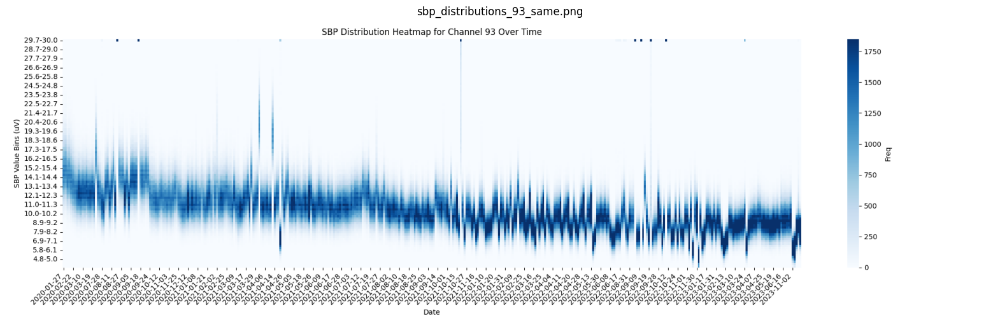

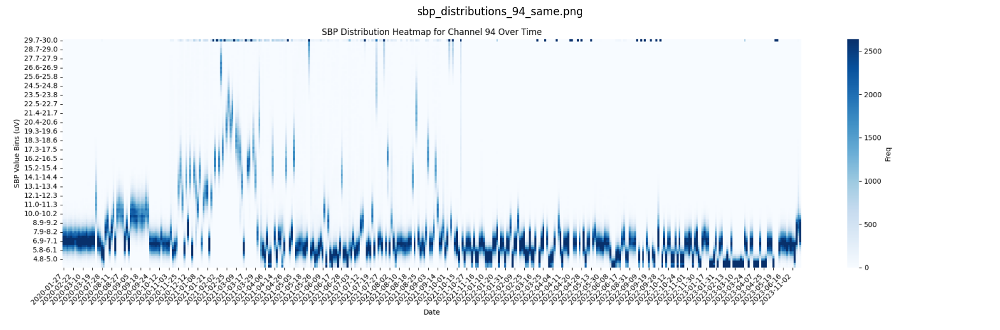

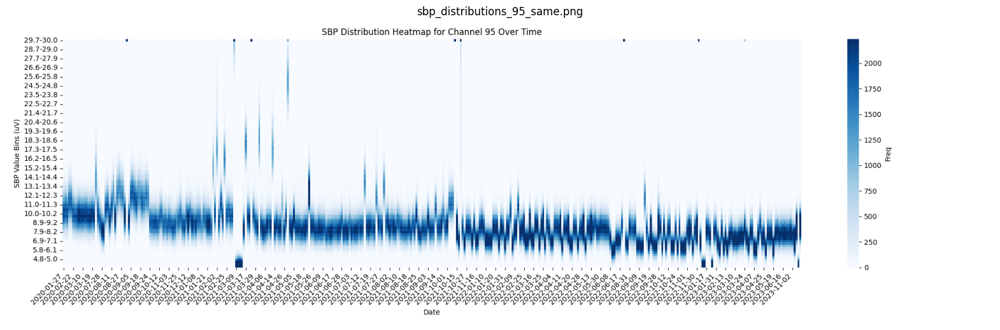

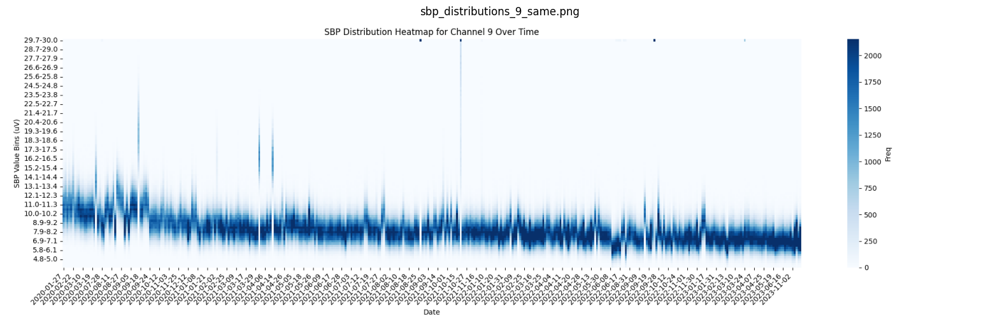

In [9]:
# The code pseudo-plotted the distribution over each channel by using ready made images. Full generation refer to the code commented in the end

import glob
from PIL import Image
png_files = glob.glob(os.path.join(outputdir, "sbp_distributions_*_same.png"))

for png_file in png_files:
    img = Image.open(png_file)
    plt.figure(figsize=(20,10))
    plt.imshow(img)
    plt.axis('off')  # Hide axes
    plt.title(os.path.basename(png_file))
    plt.show()

# The following code actually plots the distribution from the distribution data calculated, but it will take significantly more time and thus not recommended
# from plotters.SBP import signal_distribution_all_ch
# #warning: takes a very long time
# signal_distribution_all_ch(dates,preprocessingdir,characterizationdir)